In [1]:
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib
import glob
import os
import mne
import connectome
import pandas as pd

from nilearn import image
from nilearn import plotting
from nilearn import datasets
from nilearn.connectome import ConnectivityMeasure
from nilearn.maskers import MultiNiftiLabelsMasker
from nilearn.maskers import MultiNiftiMasker
from nilearn.maskers import MultiNiftiMapsMasker

from nilearn import image
import fmriprep
import ants

from sklearn.kernel_ridge import KernelRidge


path = 'data/'
atlas = 'AAL'
correlation_measure = 'correlation' #can be also tangent, partial
res_n = 1


/usr/lib/python3/dist-packages/paramiko/transport.py:236: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
colnames=['idx','anatomical_label'] 
res = f'{res_n}x{res_n}x{res_n}'
atlas_path = path + f'/atlases/lawrance2021/label/Human/ICBM/' + atlas + '_space-ICBM2009c_res-' + res + '.nii.gz'
atlas_path_not_trans = path + f'/atlases/lawrance2021/label/Human/' + atlas + '_space-MNI152NLin6_res-' + res + '.nii.gz'
reference_path = path + '/atlases/lawrance2021/reference_brains/MNI152NLin6_res-1x1x1_T1w_descr-brain.nii.gz'
templateLin6 = path + '/atlases/lawrance2021/reference_brains/MNI152NLin6_res-1x1x1_T1w.nii.gz'
templateICBM = '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/atlases/templates/mni_icbm152_t1_tal_nlin_asym_09c.nii' ##use the ICBM T1 template

path_subjects = path + 'func_images/AOMIC/prep_nifti/'


anatomic_path = path + f'/atlases/lawrance2021/label/Human/Anatomical-labels-csv/' + atlas + '.csv'
anatomic_path2 = path + f'/atlases/lawrance2021/label/Human/Anatomical-labels-csv/' + 'Brodmann' + '.csv'

ana_labels = pd.read_csv(anatomic_path,names=colnames, header=None)
ana_labels2 = pd.read_csv(anatomic_path2,names=colnames, header=None)

imgs_paths = glob.glob(path + 'func_images/AOMIC/prep_nifti/*000*.nii')
ana_labels.anatomical_label[0]

NaN  NaN  NaN  NaN   NaN
Name: anatomical_label, dtype: float64

In [3]:
from scipy.stats import uniform

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold, RandomizedSearchCV

params_dist = {'C' : uniform(loc = 0.1 , scale = 10),
                'epsilon': uniform(loc = 0.001, scale = 0.1)
                }


len(params_dist)

inner_cv = KFold(n_splits=3, shuffle=True, random_state=1)

import regresson
path = 'data/'
regressors_df =  regresson.load_regressors(path + 'func_images/AOMIC/regressors/*.txt')


In [5]:
regressors_df['regressor_edu']

0      0
1      0
2      1
3      1
4      1
      ..
876    0
877    0
878    0
879    1
880    0
Name: regressor_edu, Length: 881, dtype: int64

In [67]:
np.mean(np.zeros([3,7]),axis = 0).shape

(7,)

In [38]:
ana_labels3 = ana_labels2[ana_labels2['idx'] != 0]

#print(ana_labels2.head)
print(ana_labels3.head)

""" ana_labels4 = ana_labels[ana_labels['idx'] != 0]
print(ana_labels4.head)
print(ana_labels.head) """


<bound method NDFrame.head of     idx     anatomical_label
1     1      Brodmann_area_1
2     2      Brodmann_area_2
3     3      Brodmann_area_3
4     4      Brodmann_area_4
5     5      Brodmann_area_5
6     6      Brodmann_area_6
7     7      Brodmann_area_7
8     8      Brodmann_area_8
9     9      Brodmann_area_9
10   10     Brodmann_area_10
11   11  Brodmann_area_11_12
12   12     Brodmann_area_17
13   13     Brodmann_area_18
14   14     Brodmann_area_19
15   15     Brodmann_area_20
16   16     Brodmann_area_21
17   17     Brodmann_area_22
18   18  Brodmann_area_23_31
19   19     Brodmann_area_24
20   20     Brodmann_area_25
21   21     Brodmann_area_26
22   22     Brodmann_area_27
23   23     Brodmann_area_28
24   24     Brodmann_area_29
25   25     Brodmann_area_30
26   26  Brodmann_area_32_33
27   27     Brodmann_area_34
28   28     Brodmann_area_35
29   29     Brodmann_area_36
30   30     Brodmann_area_37
31   31     Brodmann_area_38
32   32     Brodmann_area_39
33   33     B

" ana_labels4 = ana_labels[ana_labels['idx'] != 0]\nprint(ana_labels4.head)\nprint(ana_labels.head) "

In [45]:
ana_labels['anatomical_label'].iloc[np.triu_indices(ana_labels.shape[0])[0]]

#np.triu_indices(ana_labels3.shape[0])

0                               R_Hippocampus
0                               R_Hippocampus
0                               R_Hippocampus
0                               R_Hippocampus
0                               R_Hippocampus
                       ...                   
80             R_Pre-subgenual_frontal_cortex
80             R_Pre-subgenual_frontal_cortex
81    L_Superior_temporal_gyrus_anterior_part
81    L_Superior_temporal_gyrus_anterior_part
82    R_Superior_temporal_gyrus_anterior_part
Name: anatomical_label, Length: 3486, dtype: object

/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning:





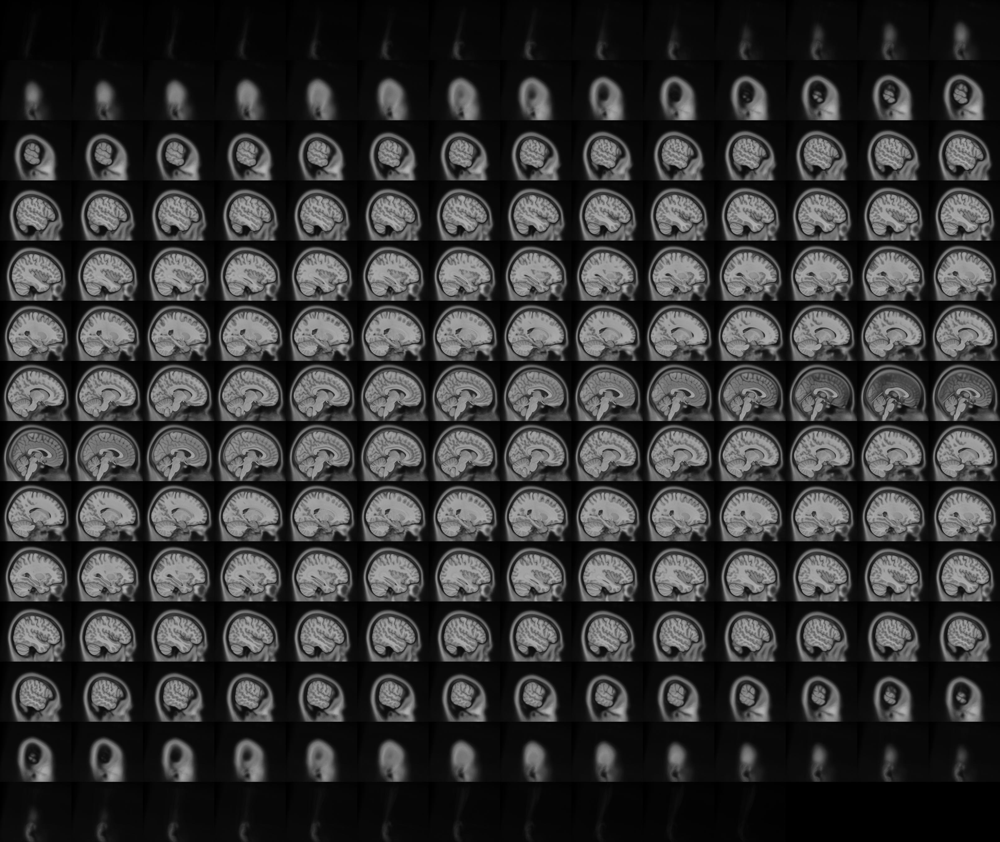
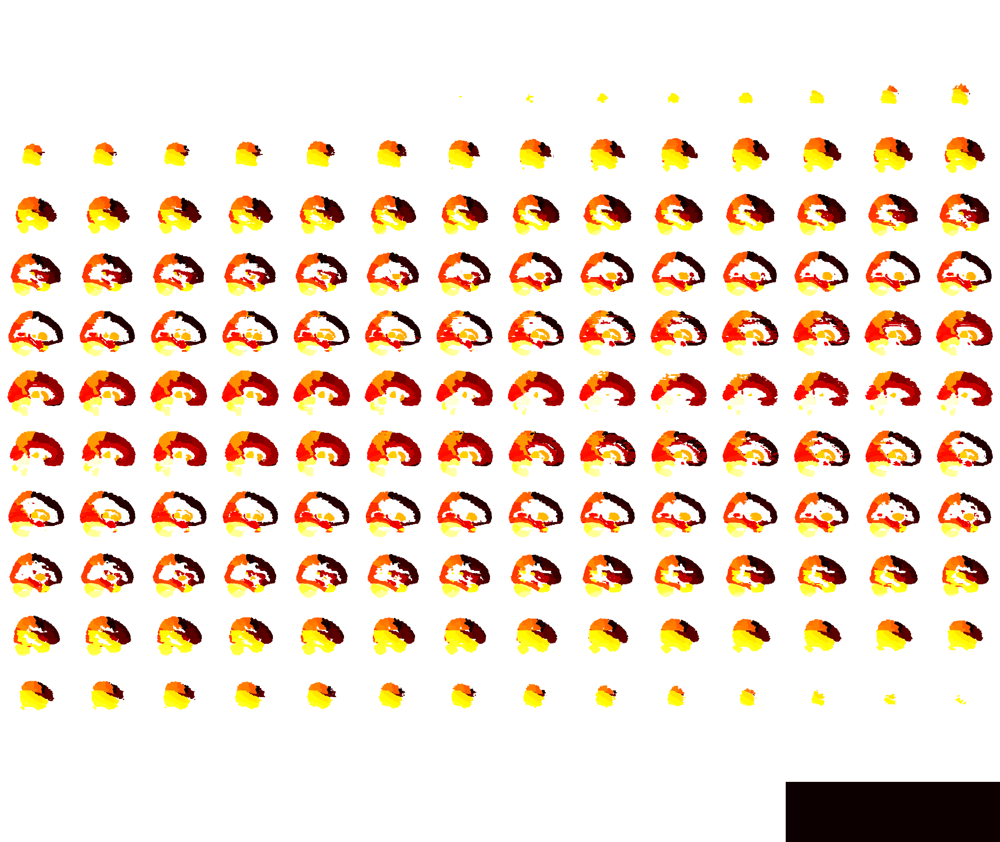

In [45]:
plotting.view_img(atlas_path,templateICBM,alpha=0.2)

/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning:


/kyb/agks/sheczko/.local/lib/python3.10/site-packages/nilearn/plotting/html_document.py:59: UserWarning:

It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.




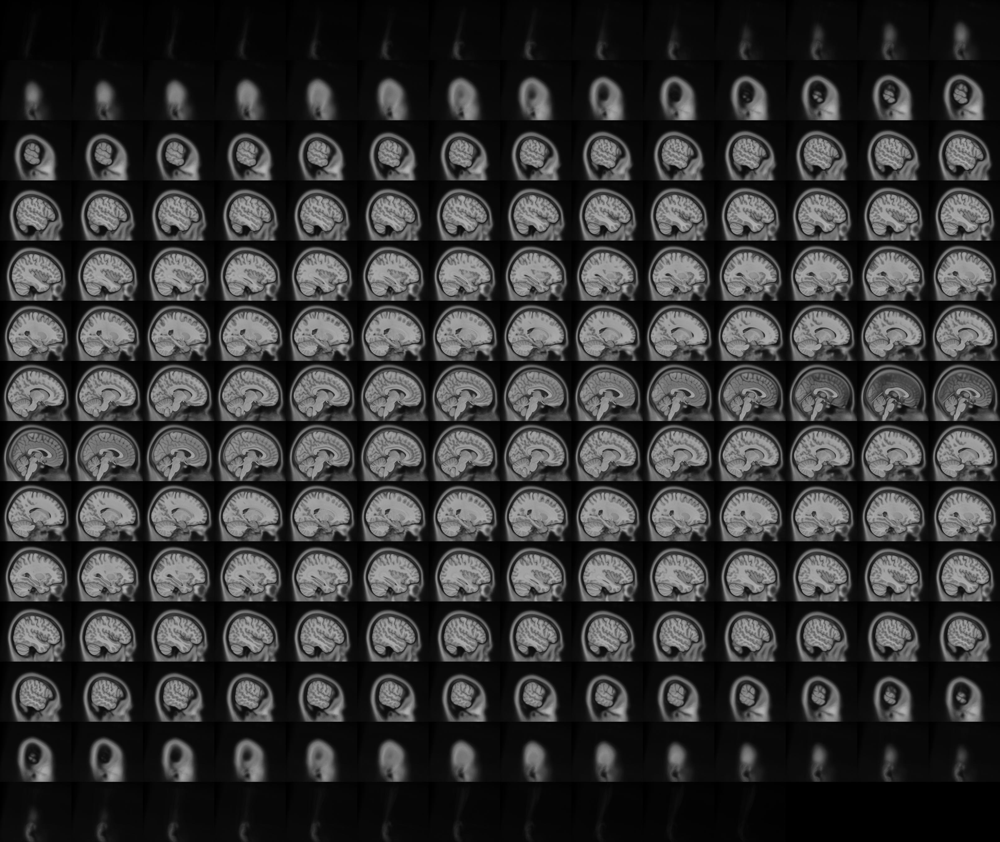
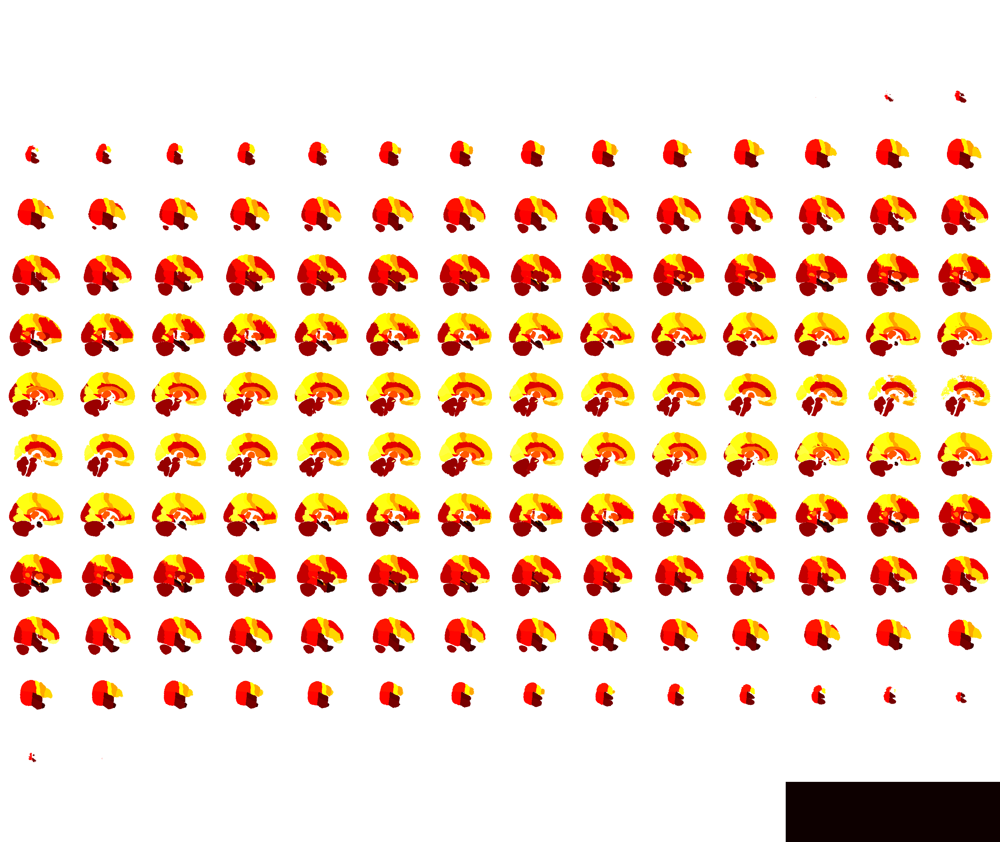

In [205]:
plotting.view_img(atlas_path_not_trans,templateICBM,alpha=0.2)


In [47]:
#print(imgs_paths)
#schaefer = datasets.fetch_atlas_schaefer_2018(n_rois = 400,resolution_mm = 2)

ICA_path = '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/results/ICA/canICA_space-IBCM_WB_mask_ncomp_200.nii.gz'
connectome_measure = ConnectivityMeasure(kind = 'partial correlation')
masker = MultiNiftiMapsMasker(maps_img = ICA_path, standardize= True, n_jobs = -1)
time_series = masker.fit_transform(imgs_paths)

In [41]:
len(time_series)

8

In [7]:
df.loc[df.select_dtypes(include=np.number).idxmax()]

NameError: name 'df' is not defined

In [183]:
df

,subject_0,subject_1,subject_2,subject_3,subject_4,subject_5,subject_6,subject_7,brain_area_1,brain_area_2
0,-0.200312,0.571830,0.749942,0.598914,0.295426,0.584031,0.309490,0.108643,R_Hippocampus,L_Hippocampus
1,0.774732,0.697455,0.827825,0.796946,0.728923,0.766087,0.657114,0.648639,R_Hippocampus,R_Amygdala
2,0.138031,0.399291,0.589079,0.541487,0.224948,0.597208,0.234359,0.058357,R_Hippocampus,L_Amygdala
3,0.525566,0.514611,0.676933,0.573907,0.561153,0.577467,0.343984,0.609114,R_Hippocampus,R_Anterior_temporal_lobe_medial_part
4,-0.098830,0.365296,0.442561,0.426118,0.326375,0.503812,0.091149,-0.039126,R_Hippocampus,L_Anterior_temporal_lobe_medial_part
...,...,...,...,...,...,...,...,...,...,...
3398,-0.088811,0.370033,0.230186,0.267177,0.050729,0.263076,0.121757,0.167803,L_Pre-subgenual_frontal_cortex,L_Superior_temporal_gyrus_anterior_part
3399,0.219976,0.412967,0.162039,0.220811,0.194596,0.310161,0.174132,0.059558,L_Pre-subgenual_frontal_cortex,R_Superior_temporal_gyrus_anterior_part
3400,-0.083990,0.295550,0.173184,0.279499,0.005921,0.245682,0.179898,0.171001,R_Pre-subgenual_frontal_cortex,L_Superior_temporal_gyrus_anterior_part
3401,0.266661,0.390177,0.019474,0.172344,0.141486,0.289068,0.164820,0.108917,R_Pre-subgenual_frontal_cortex,R_Superior_temporal_gyrus_anterior_part


In [7]:
coords = plotting.find_parcellation_cut_coords(labels_img = atlas_path)

In [14]:
c, ci = connectome.connectome(time_series=time_series)

In [15]:
c.shape

(8, 83, 83)

In [23]:
""" plt.imshow(correlation[0])
plt.show()
plt.imshow(flat_c.reshape(8,83,83)[0]) """

#grid = np.meshgrid(np.arange(3),np.arange(3))

TypeError: Invalid shape (15,) for image data

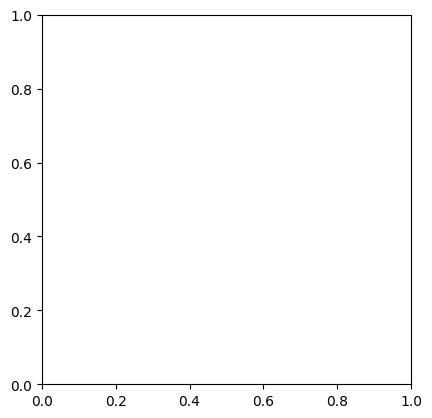

In [52]:
#plt.imshow(np.indices((83,83))[1])
cut_corr = correlation[0,:5,:5]
correlation[np.triu_indices(3, k = 1)] ##fist number the shape, second to include the diagonal

plt.imshow(cut_corr[np.triu_indices(cut_corr.shape[0])])
plt.colorbar
np.indices(cut_corr.shape)

ana_labels


In [65]:
df = pd.DataFrame()

for column_i in range(correlation.shape[0]):###each subject is their own column
    df[f'subject_{column_i}'] = correlation[column_i][np.triu_indices(correlation.shape[1], k = 1)]


In [156]:
df_test = connectome.save_connectomes_df(correlation_matrices = correlation,anatomic_labels=ana_labels,path_to_save = path, atlas_name=atlas,n_subjects=8,correlation_measure=correlation_measure)

In [126]:
import importlib
importlib.reload(connectome)


<module 'connectome' from '/kyb/agks/sheczko/Downloads/MastersThesis/code/connectome.py'>

In [120]:
df_test.equals(df)

True

In [71]:
np.triu_indices(correlation.shape[1], k = 1)[0]

array([ 0,  0,  0, ..., 80, 80, 81])

In [164]:
#df_test[(df_test.brain_area_1 == 'L_Amygdala') | (df_test.brain_area_2 == 'L_Amygdala')]

df_test_2 = pd.read_csv(path + 'n_sub-8_correlationType-correlation_atlas-Hammersmith.csv',index_col=[0])

unchanged_rows = df_test_2.merge(df_test, how='inner', indicator=False)
unchanged_rows

comparison = df_test_2.compare(df_test, keep_shape=True, keep_equal=False)
comparison

subject_0           subject_1           subject_2           subject_3   
          self     other      self     other      self     other      self   
0    -0.200312 -0.200312  0.571830  0.571830  0.749942  0.749942  0.598914  \
1     0.774732  0.774732  0.697455  0.697455  0.827825  0.827825  0.796946   
2     0.138031  0.138031  0.399291  0.399291  0.589079  0.589079  0.541487   
3     0.525566  0.525566  0.514611  0.514611  0.676933  0.676933  0.573907   
4    -0.098830 -0.098830  0.365296  0.365296  0.442561  0.442561  0.426118   
...        ...       ...       ...       ...       ...       ...       ...   
3398 -0.088811 -0.088811  0.370033  0.370033  0.230186  0.230186  0.267177   
3399  0.219976  0.219976  0.412967  0.412967  0.162039  0.162039  0.220811   
3400 -0.083990 -0.083990  0.295550  0.295550  0.173184  0.173184  0.279499   
3401  0.266661  0.266661  0.390177  0.390177  0.019474  0.019474  0.172344   
3402 -0.761773 -0.761773  0.651419  0.651419  0.532976  0.532976  0.666335   

               subject_4           subject_5           subject_6             
         other      self     other      self     other      self     other   
0     0.598914  0.295426  0.295426  0.584031  0.584031  0.309490  0.309490  \
1     0.796946  0.728923  0.728923  0.766087  0.766087  0.657114  0.657114   
2     0.541487  0.224948  0.224948  0.597208  0.597208  0.234359  0.234359   
3     0.573907  0.561153  0.561153  0.577467  0.577467  0.343984  0.343984   
4     0.426118  0.326375  0.326375  0.503812  0.503812  0.091149  0.091149   
...        ...       ...       ...       ...       ...       ...       ...   
3398  0.267177  0.050729  0.050729  0.263076  0.263076  0.121757  0.121757   
3399  0.220811  0.194596  0.194596  0.310161  0.310161  0.174132  0.174132   
3400  0.279499  0.005921  0.005921  0.245682  0.245682  0.179898  0.179898   
3401  0.172344  0.141486  0.141486  0.289068  0.289068  0.164820  0.164820   
3402  0.666335  0.368514  0.368514  0.356018  0.356018  0.092396  0.092396   

     subject_7           brain_area_1       brain_area_2        
          self     other         self other         self other  
0     0.108643  0.108643          NaN   NaN          NaN   NaN  
1     0.648639  0.648639          NaN   NaN          NaN   NaN  
2     0.058357  0.058357          NaN   NaN          NaN   NaN  
3     0.609114  0.609114          NaN   NaN          NaN   NaN  
4    -0.039126 -0.039126          NaN   NaN          NaN   NaN  
...        ...       ...          ...   ...          ...   ...  
3398  0.167803  0.167803          NaN   NaN          NaN   NaN  
3399  0.059558  0.059558          NaN   NaN          NaN   NaN  
3400  0.171001  0.171001          NaN   NaN          NaN   NaN  
3401  0.108917  0.108917          NaN   NaN          NaN   NaN  
3402  0.000822  0.000822          NaN   NaN          NaN   NaN  

[3403 rows x 20 columns]

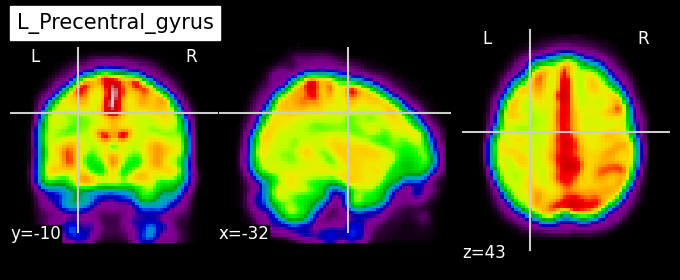

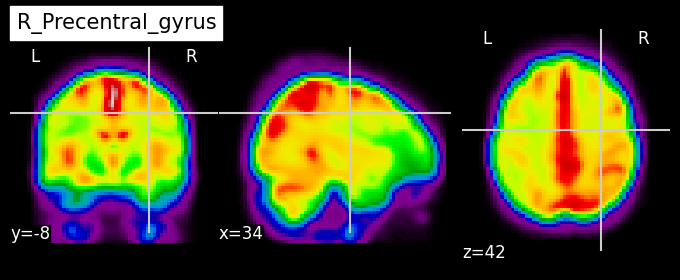

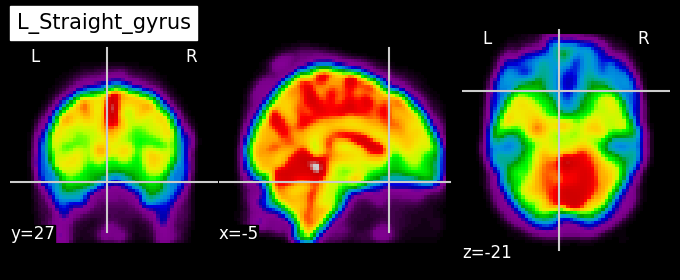

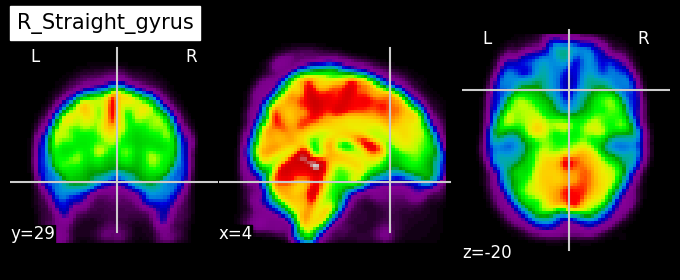

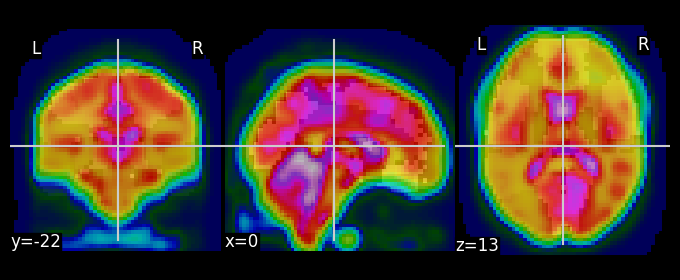

In [20]:
#plotting.plot_matrix(mean_[:50,:50],labels = schaefer['labels'][:50])
#plotting.show()
#plotting.plot_matrix(mean_)
#plotting.show()
rangeC = np.arange(49,53)
for n in rangeC:
    plotting.plot_epi(image.mean_img(imgs_paths[5]),cut_coords=coords[n],title = f'{ana_labels.anatomical_label[n]}')
    plotting.show()
plotting.plot_roi(image.mean_img(imgs_paths[6]),atlas_path)



/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



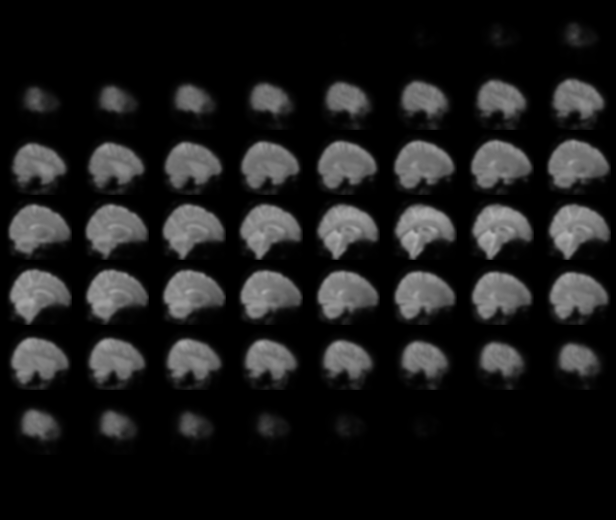
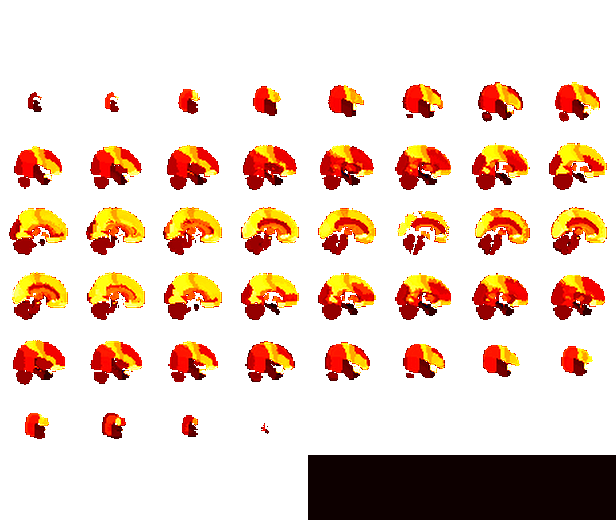

In [22]:
plotting.view_img(atlas_path,bg_img = image.mean_img(imgs_paths[5]),title='using the prep_nifi')


/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



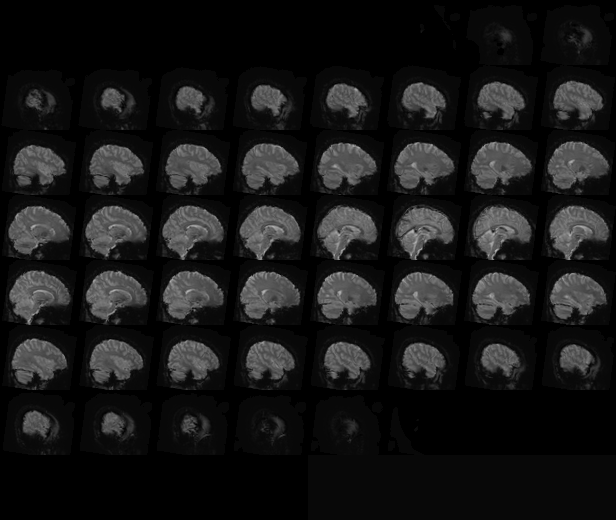
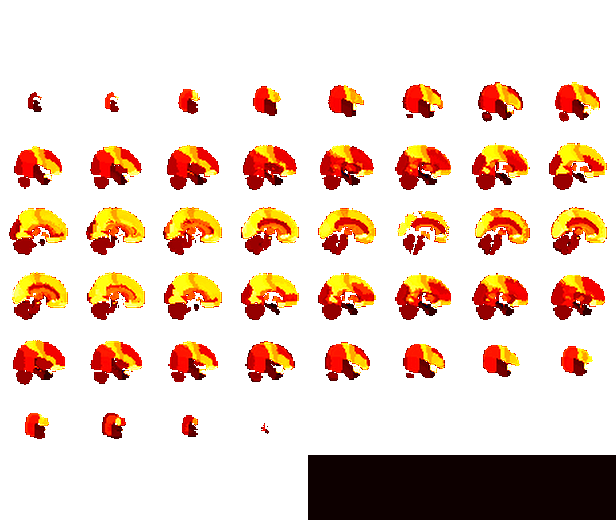

In [23]:
path_prep_AOMIC = path + 'func_images/AOMIC/sub-0001_task-moviewatching_space-MNI152NLin2009cAsym_desc-preproc_bold.nii.gz'
plotting.view_img(atlas_path,bg_img = image.mean_img(path_prep_AOMIC),title='using the AOMIC provided preproc file')



/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



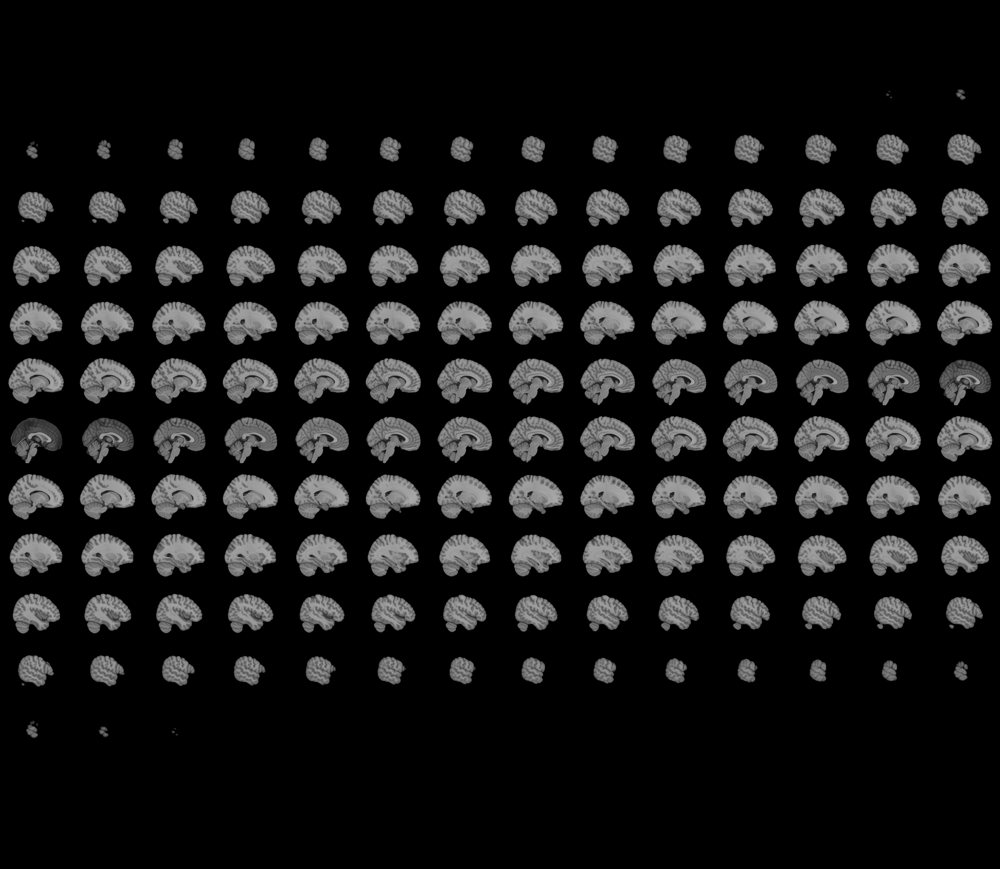
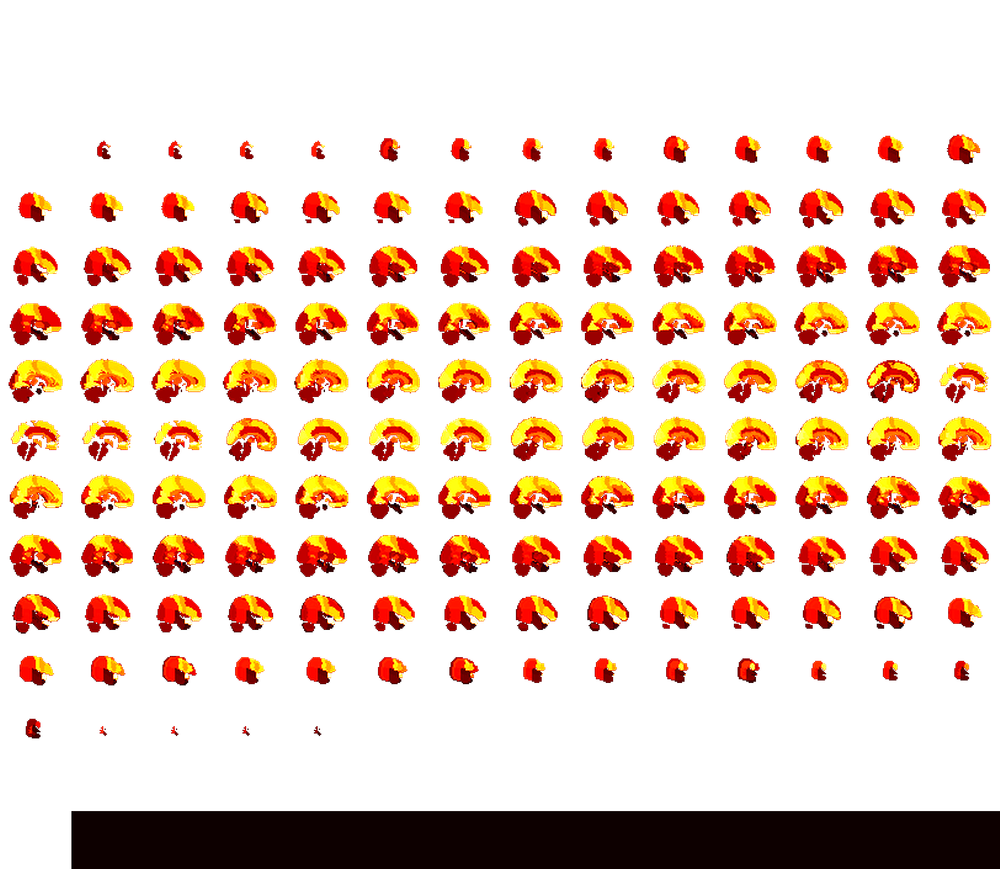

In [25]:
plotting.view_img(atlas_path)

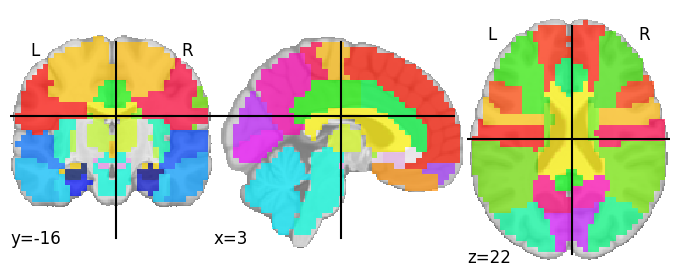

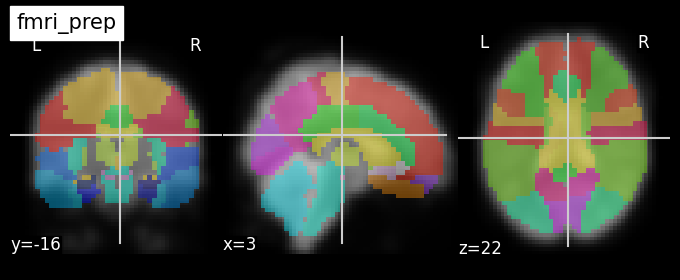

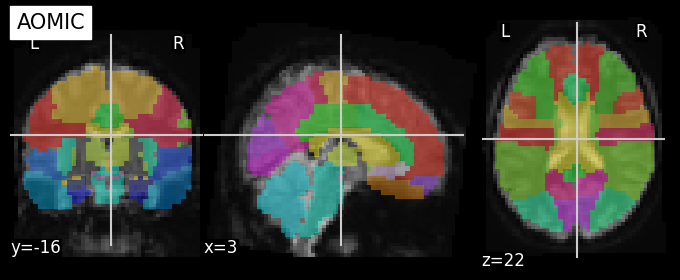

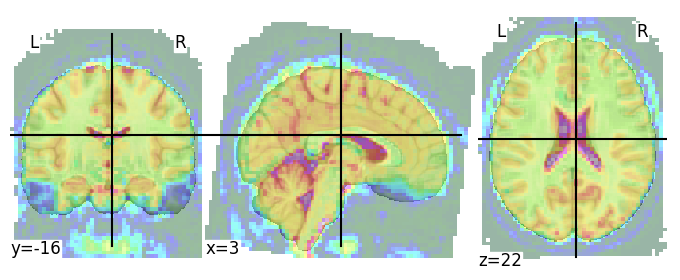

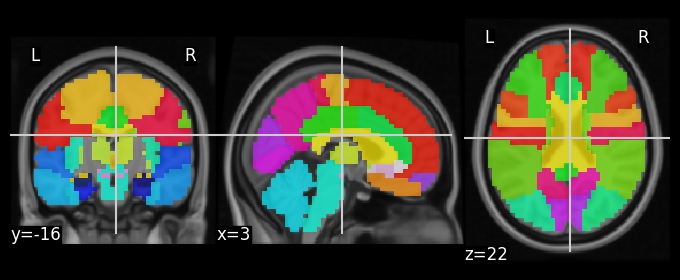

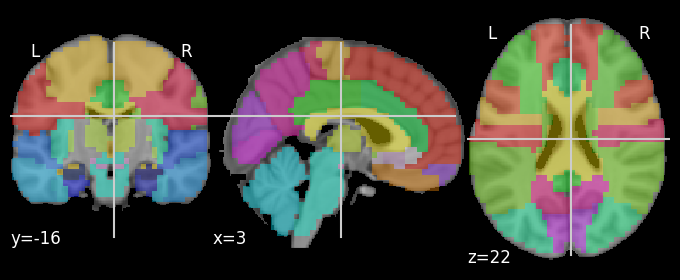

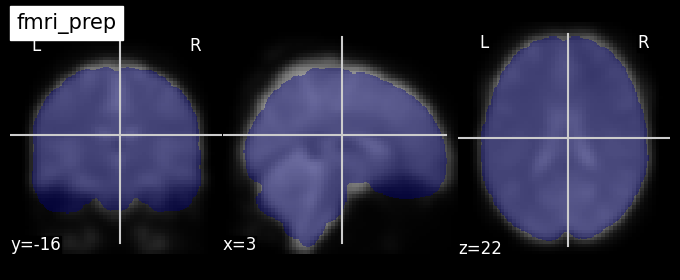

In [94]:
coord_cut = np.array([3,-16,22])
plotting.plot_roi(atlas_path,cut_coords=coord_cut)
plotting.show()
plotting.plot_roi(atlas_path,image.mean_img(imgs_paths[5]),title='fmri_prep',cut_coords=coord_cut,alpha=0.4)
plotting.show()
plotting.plot_roi(atlas_path,image.mean_img(path_prep_AOMIC),title="AOMIC",cut_coords=coord_cut,alpha=0.4)
plotting.show()
plotting.plot_roi(image.mean_img(path_prep_AOMIC),cut_coords=coord_cut,alpha = 0.4)
plotting.show()
plotting.plot_roi(atlas_path,reference_path2,cut_coords=coord_cut)
plotting.show()
plotting.plot_roi(atlas_path,reference_path,cut_coords=coord_cut,alpha = 0.4)
mask_c = '/kyb/agks/sheczko/Downloads/MastersThesis/code/mni_icbm152_nlin_asym_09c_nifti/mni_icbm152_nlin_asym_09c/mni_icbm152_t1_tal_nlin_asym_09c_mask.nii'
plotting.plot_roi(mask_c,image.mean_img(imgs_paths[5]),title='fmri_prep',cut_coords=coord_cut,alpha=0.4)




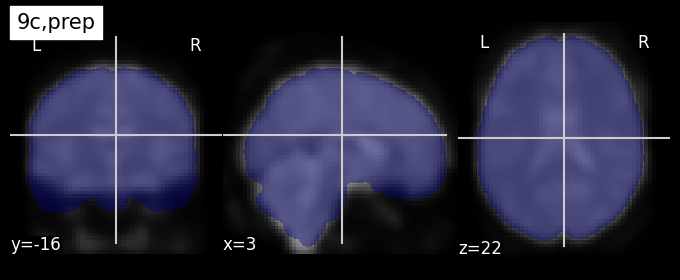

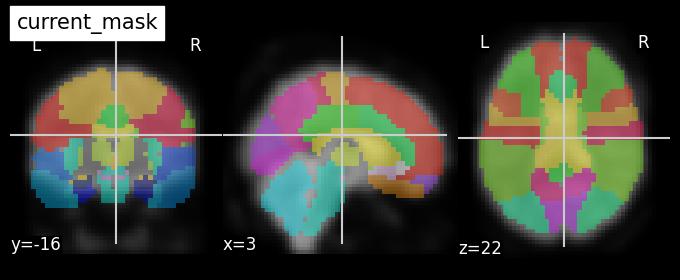

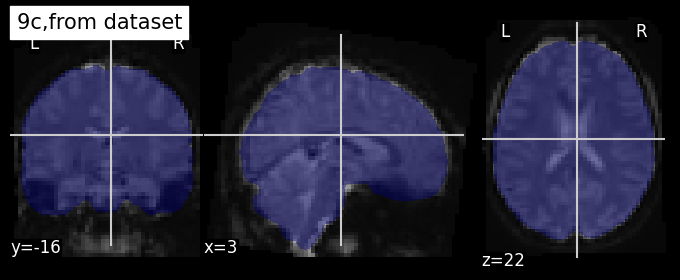

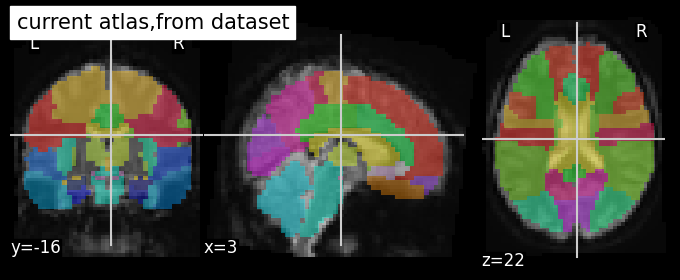

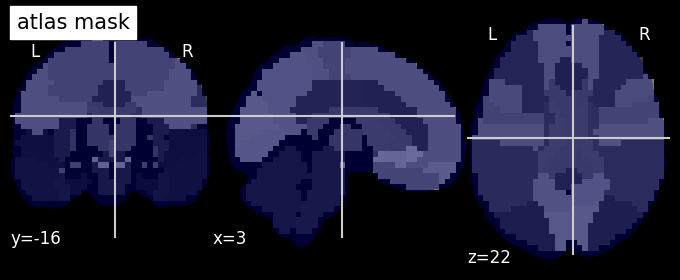

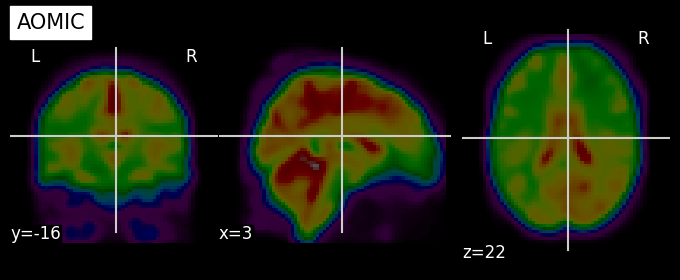

In [95]:
mask_c = '/kyb/agks/sheczko/Downloads/MastersThesis/code/mni_icbm152_nlin_asym_09c_nifti/mni_icbm152_nlin_asym_09c/mni_icbm152_t1_tal_nlin_asym_09c_mask.nii'
plotting.plot_roi(mask_c,image.mean_img(imgs_paths[7]),title='9c,prep',cut_coords=coord_cut,alpha=0.4)
plotting.plot_roi(atlas_path,image.mean_img(imgs_paths[7]),title='current_mask',cut_coords=coord_cut,alpha=0.4,threshold=0.1)
plotting.plot_roi(mask_c,image.mean_img(path_prep_AOMIC),title='9c,from dataset',cut_coords=coord_cut,alpha=0.4)
plotting.plot_roi(atlas_path,image.mean_img(path_prep_AOMIC),title='current atlas,from dataset',cut_coords=coord_cut,alpha=0.4)

plotting.show()
plotting.plot_roi(mask_c,atlas_path,title="atlas mask",cut_coords=coord_cut,alpha=0.4)
plotting.plot_epi(image.mean_img(imgs_paths[5]),title="AOMIC",cut_coords=coord_cut,alpha=0.4)



/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/kyb/agks/sheczko/.local/lib/python3.10/site-packages/nilearn/image/resampling.py:274: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  warnings.warn("Resampling binary images with continuous or "
/kyb/agks/sheczko/.local/lib/python3.10/site-packages/nilearn/plotting/html_document.py:59: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn('It seems you have created more than {} '



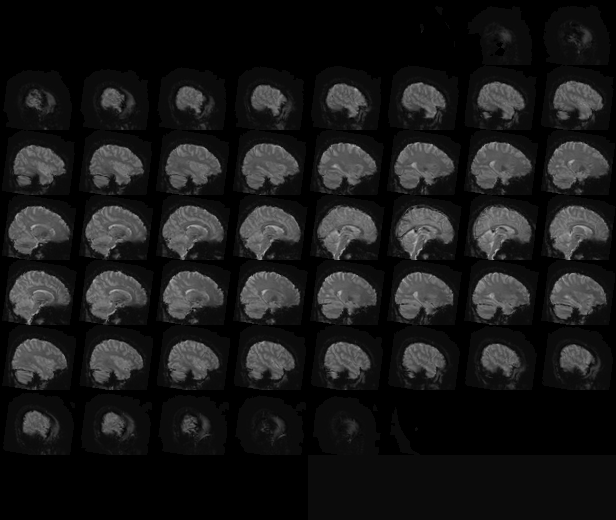
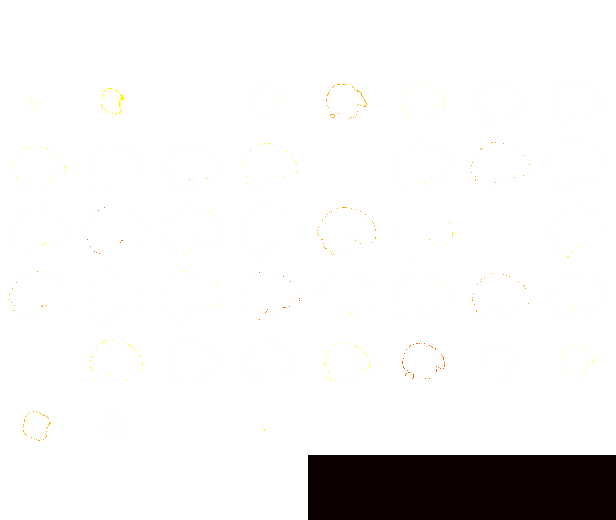

In [104]:
plotting.view_img(mask_c,image.index_img(path_prep_AOMIC,40),title="atlas mask",cut_coords=coord_cut,opacity=0.4)


/kyb/agks/sheczko/.local/lib/python3.10/site-packages/nilearn/plotting/html_stat_map.py:111: UserWarning: Threshold given was -1, but the data has no values below 0.0. 
  warnings.warn("Threshold given was {0}, but "
/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/kyb/agks/sheczko/.local/lib/python3.10/site-packages/nilearn/plotting/html_document.py:59: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn('It seems you have created more than {} '



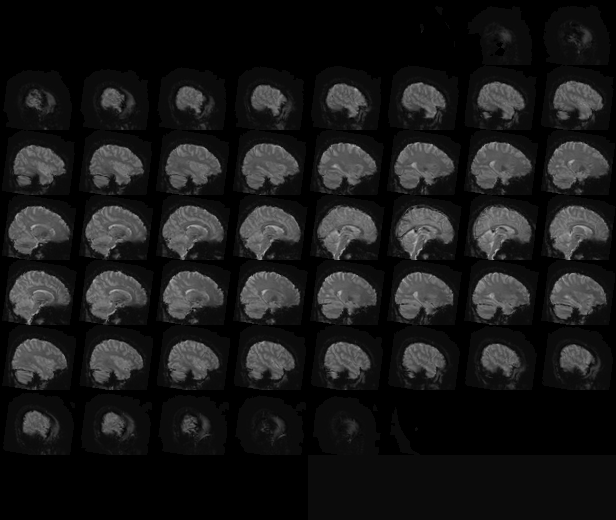
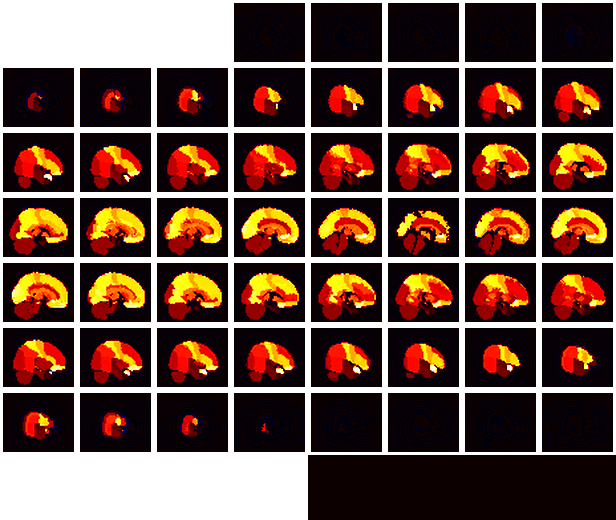

In [103]:
plotting.view_img(atlas_path,image.index_img(path_prep_AOMIC,40),title="atlas mask",cut_coords=coord_cut,opacity=0.4,threshold=-1)


In [109]:
print(nib.load('/kyb/agks/sheczko/Downloads/MastersThesis/code/data/templates/mni_icbm152_nlin_asym_09c_nifti/mni_icbm152_nlin_asym_09c/mni_icbm152_t1_tal_nlin_asym_09c.nii').header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 193 229 193   1   1   0   0]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [1. 1. 1. 1. 0. 1. 0. 0.]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 100.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'mnc2nii mni_icbm152_nlin_asym_09c/mni_icbm152_t1_tal_nlin_asym_09c.mnc mni_icbm'
aux_file        : b''
qform_code      : unknown
sform_code      : mni
quatern_b       : 0.0
quatern_c       : 0.0
quatern_d       : 0.0
qoffset_x       : 0.0
qoffset_y       : 0.0


In [108]:
print(nib.load(imgs_paths[5]).header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b''
dim_info        : 0
dim             : [  4  60  77  65 290   0   0   0]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float32
bitpix          : 32
slice_start     : 0
pixdim          : [1.0e+00 3.3e+00 3.0e+00 3.0e+00 2.2e+03 0.0e+00 0.0e+00 0.0e+00]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 18
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b''
aux_file        : b''
qform_code      : mni
sform_code      : mni
quatern_b       : 0.0
quatern_c       : 0.0
quatern_d       : 0.0
qoffset_x       : -96.0
qoffset_y       : -132.0
qoffset_z       : -78.0
srow_x         

In [110]:
class MyClass:
    """A simple example class"""
    i = 12345
    def __init__(self):
        self.m = 'hello world'

    def f(self):
        return 'hello world'
x 

In [91]:
x.counter = 1
while x.counter < 10:
    x.counter = x.counter * 2
print(x.counter)

16


In [118]:
atlas_ref = 

<bound method MyClass.f of <__main__.MyClass object at 0x7f1815380f10>>

In [101]:
hi.f()

TypeError: MyClass.f() missing 1 required positional argument: 'self'

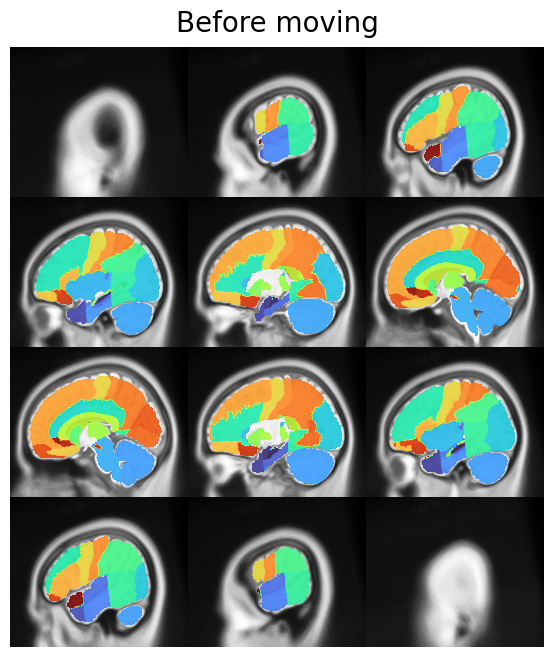

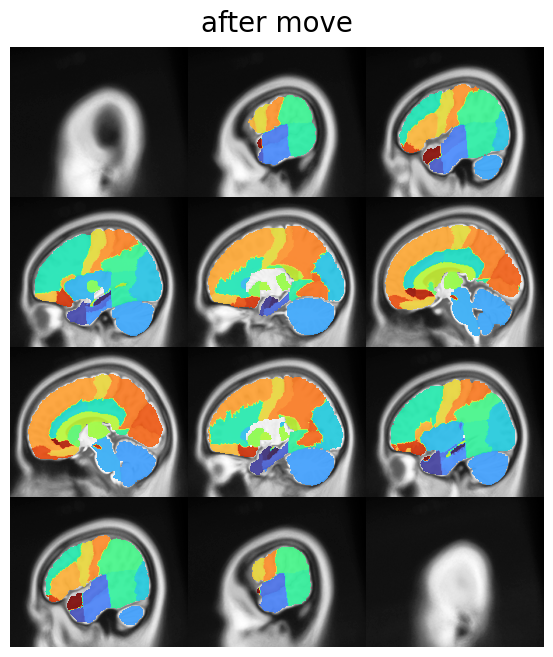

In [154]:
import ants
transform = '/kyb/agks/sheczko/Downloads/MastersThesis/neuroparc/atlases/transforms/MNI152NLin6_2_MNI152NLin2009cAsym.h5'
template = '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/templates/mni_icbm152_nlin_asym_09c_nifti/mni_icbm152_nlin_asym_09c/mni_icbm152_t1_tal_nlin_asym_09c.nii'
transform_ants = ants.ants_transform_io.read_transform(transform)

moving = ants.ants_image_io.image_read(atlas_path)
fixed = ants.ants_image_io.image_read(template)

fixed.plot(overlay=moving, title='Before moving')

moved = ants.apply_transforms(fixed = fixed,moving = moving, transformlist=transform,interpolator = 'genericLabel')
#print(moved)

fixed.plot(overlay = moved,title = 'after move')


#transform_ants = ants.ants_transform_io.read_transform(transform)

#ants.registration(fixed = ants_template, moving = ants_atlas,transform = transform_ants)

/kyb/agks/sheczko/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:784: UserWarning:


/kyb/agks/sheczko/.local/lib/python3.10/site-packages/nilearn/plotting/html_document.py:59: UserWarning:

It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.




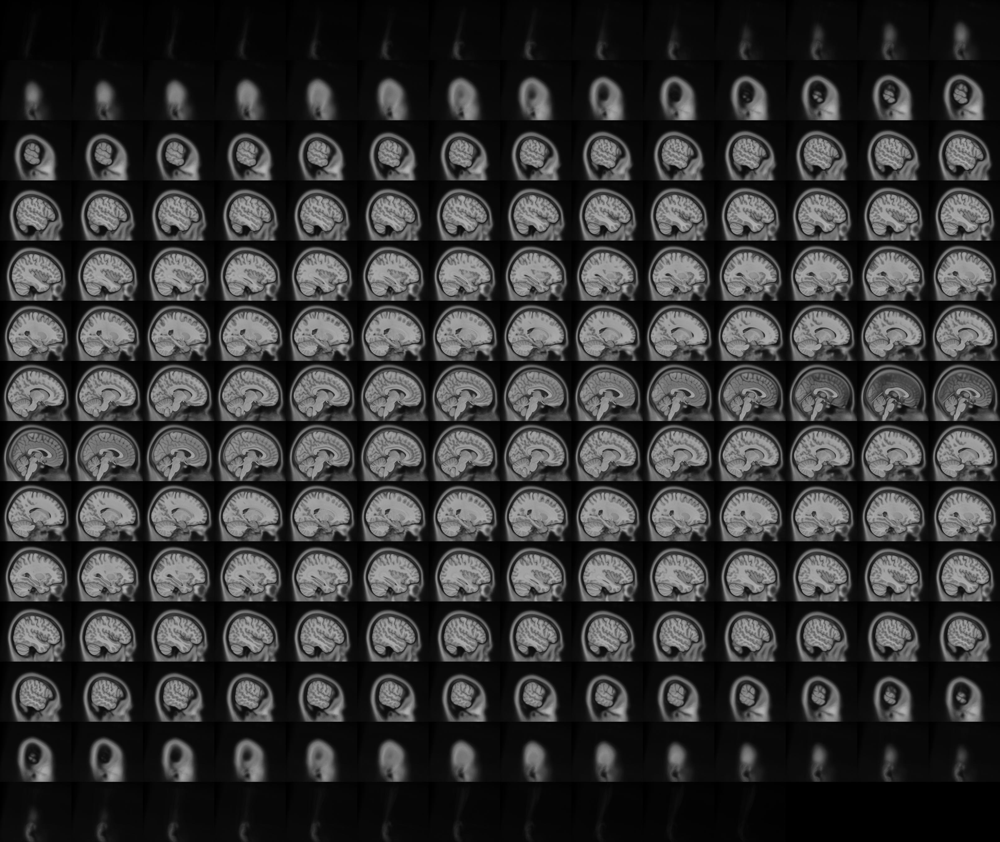
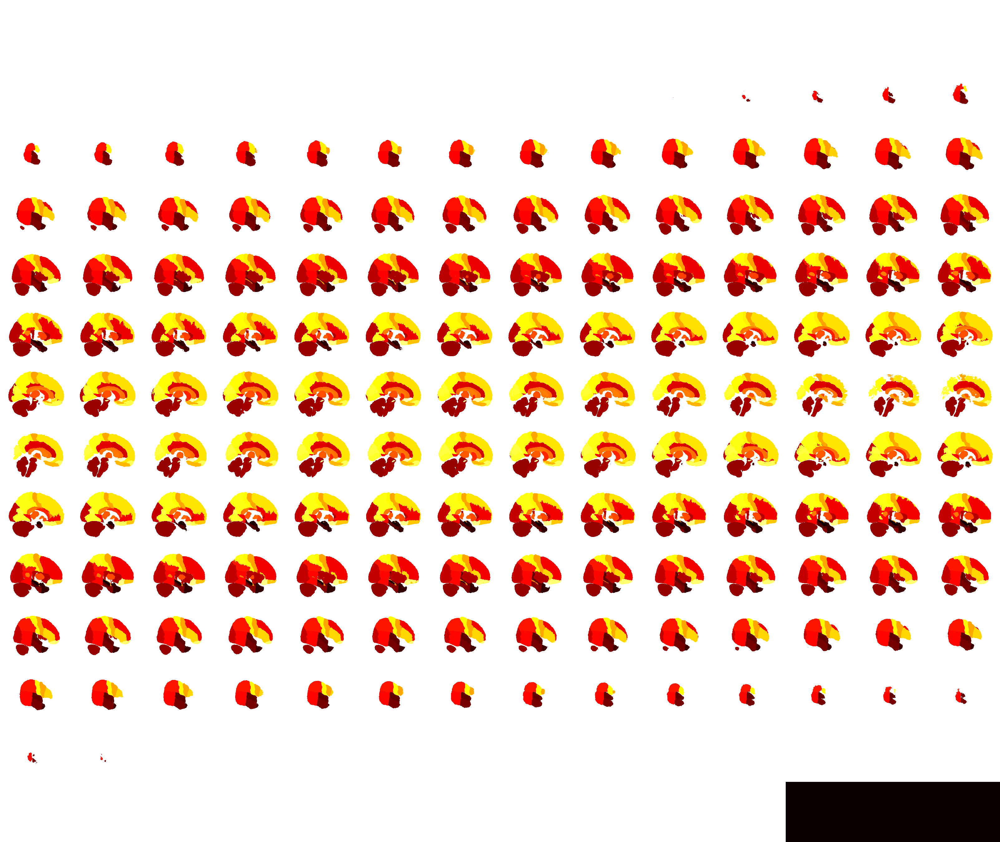

In [160]:
path
#moved.to_file(path + 'jaas.nii.gz')
plotting.view_img(path + 'jaas.nii.gz',template)

TypeError: glob() missing 1 required positional argument: 'pathname'

## regrassion model


In [58]:
regressors_path = glob.glob('/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/*.txt') ##how to extract the target variables
print(regressors_path)
#print(regressors_path)
regressors_df = pd.DataFrame()
for regressors in regressors_path:
    name_r = regressors.split('/')[-1].split('.')[0]
    print(name_r)
    regressors_df[f'{name_r}'] = pd.read_csv(regressors,header=None)



['/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_neo_n.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_ses.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_crystal.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_neo_o.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_fluid.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_neo_e.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_neo_c.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_age.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/regressor_iq.txt', '/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOM

In [108]:
missing_subs = np.zeros(sum(~regressors_df['missing'].isna()))
for reg_i, reg_ in enumerate(list(regressors_df['missing'][~regressors_df['missing'].isna()])):
    missing_subjectss[reg_i] = int(reg_.split('-')[-1])

In [113]:
missing_subs
test = pd.read_csv('/kyb/agks/sheczko/Downloads/MastersThesis/code/data/results/n_sub-881_correlationType-correlation_atlas-Schaefer200.csv')


In [378]:
sorted_df = test.sort_index(axis=1) ##how to extract the features
sorted_df.loc[:,sorted_df.columns.str.startswith('sub')].T


regressors_df['subj']


0      proc sub-0001
1      proc sub-0002
2      proc sub-0003
3      proc sub-0004
4      proc sub-0005
           ...      
876    proc sub-0877
877    proc sub-0878
878    proc sub-0879
879    proc sub-0880
880    proc sub-0881
Name: subj, Length: 881, dtype: object

In [122]:
import sklearn

In [24]:
#import relevant libraries
import sys; sys.path
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import time
import regresson

from sklearn.metrics import explained_variance_score, r2_score
from sklearn.linear_model import Ridge
#from sklearn.kernel_ridge import KernelRidge
#from sklearn.linear_model import Lasso
#from sklearn.svm import SVR
#from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import StandardScaler
#from sklearn.linear_model import ElasticNet
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold
from sklearn.feature_selection import r_regression

#from sklearn.preprocessing import StandardScaler
#from sklearn.pipeline import Pipeline


# find the connectome data

In [18]:
#to get the fc in correct format

fc_panda = pd.read_csv('/kyb/agks/sheczko/Downloads/MastersThesis/code/data/results/connectomes/n_sub-881_correlationType-correlation_atlas-AAL.csv') #load in the desired datafile
sorted_df = fc_panda.sort_index(axis=1) ##sort for subjects in order
print(sorted_df.columns)
print(f'currently the shape of the array is {sorted_df.shape}. We need to cut the columns which dont contain subject connectome data)')
fc = sorted_df.loc[:,sorted_df.columns.str.startswith('sub')].T.values # derive the pure connectome as np array where each subjerct has a row, to fit the sklearn convention


Index(['Unnamed: 0', 'brain_area_1', 'brain_area_2', 'subject_0001',
       'subject_0002', 'subject_0003', 'subject_0004', 'subject_0005',
       'subject_0006', 'subject_0007',
       ...
       'subject_0918', 'subject_0919', 'subject_0920', 'subject_0921',
       'subject_0922', 'subject_0923', 'subject_0924', 'subject_0925',
       'subject_0926', 'subject_0927'],
      dtype='object', length=884)
currently the shape of the array is (6670, 884). We need to cut the columns which dont contain subject connectome data)


In [17]:
test_fc = regresson.load_data('/kyb/agks/sheczko/Downloads/MastersThesis/code/data/results/connectomes/tangent_relevant/n_sub-881_correlationType-tangent_atlas-canICA100.csv') ##load an exampl  the connectome

In [112]:
featimp = np.zeros([perm,n_feat,n_cog])

# find the target data

In [10]:
#get the cognitive traits in correct format
regressors_path = glob.glob('/kyb/agks/sheczko/Downloads/MastersThesis/code/data/func_images/AOMIC/regressors/*.txt') ##how to extract the target variables
#print(regressors_path)
regressors_df = pd.DataFrame()
for regressors in regressors_path:
    name_r = regressors.split('/')[-1].split('.')[0]
    #print(name_r)
    regressors_df[f'{name_r}'] = pd.read_csv(regressors,header=None) ##in this format each subject has a row, to test the model we can try to predict the subject id (presumably random)

##extract the traget variables

subj_ids = np.zeros(regressors_df.shape[0])
#extract subject IDs from subj_data table
for subj_id_i, subj_id in enumerate(regressors_df['subj'].astype('str')):
    subj_ids[subj_id_i] = int(subj_id.split('-')[-1])

regressors_df['subj_ids'] = subj_ids


#choose traget variables from the df
GCA = regressors_df.regressor_iq.values
bmi = regressors_df.regressor_bmi.values
edu = regressors_df.regressor_edu.values
#fluid = regressors_df.regressor_fluid
#age = regressors_df.regressor_age
subj_id_np = regressors_df.subj_ids.values

#concatenate cognitive metrics into single variable
cognition = ['GCA','bmi']
#cognition = ['PMAT Correct', 'PMAT Response Time']
cog_metric = np.transpose(np.asarray([GCA, bmi, edu]))
#cog_metric = np.transpose(np.asarray([pmat_cr, pmat_med]))
cog_metric



array([[159.,  23.,   0.],
       [199.,  20.,   0.],
       [227.,  31.,   1.],
       ...,
       [150.,  30.,   0.],
       [161.,  22.,   1.],
       [190.,  35.,   0.]])

# set model parameters

In [11]:
from sklearn.preprocessing import StandardScaler
 
object= StandardScaler()
 

#set the number of permutations you want to perform
perm = 3
#set the number of cross-validation loops you want to perform
cv_loops = 5
#set the number of folds you want in the inner and outer folds of the nested cross-validation
k = 3
#set the proportion of data you want in your training set
train_size = .8
#set the number of variable you want to predict to be the number of variables stored in the cognition variablse
n_cog = np.size(cognition)

#set regression model type

regr = Ridge(fit_intercept = True, max_iter=1000000)

#set hyperparameter grid space you want to search through for the model
alphas = np.linspace(5, 30, num=50, endpoint=True, dtype=None, axis=0)

#set the param grid be to the hyperparamters you want to search through
paramGrid ={'alpha': alphas}

#set x data to be the input variable you want to use
#ie fc, sc, or hc
X = fc
X[X<0] = 0


 # standardization -- optional (test if works better)
#X_norm = object.fit_transform(X) 
#print(scale)

#set y to be the cognitive metrics you want to predict
Y = cog_metric
#Y - Y.mean(axis=0)



#set the number of features 
n_feat = X.shape[1]

NameError: name 'fc' is not defined

In [107]:
print(X.shape)
Y.shape



x_train, x_test, cog_train, cog_test = train_test_split(X, Y, test_size= 1-train_size, 
                                                            shuffle=True, random_state=0)

w_edu = r_regression(x_test,cog_test[:,2])

w_cog = r_regression(x_train,cog_train[:,0])
w_prod = w_cog * w_edu
w_prod[w_prod < 0] = 0
w_prod_norm = (w_prod - np.min(w_prod))/(np.max(w_prod)-np.min(w_prod))

h_idx = np.argpartition(w_prod_norm,-1000)[-1000:]
x_train[:,h_idx].shape


(881, 4950)


(704, 1000)

(array([2.784e+03, 3.170e+02, 2.410e+02, 2.050e+02, 1.410e+02, 1.370e+02,
        1.240e+02, 1.120e+02, 9.400e+01, 8.600e+01, 7.600e+01, 7.600e+01,
        5.800e+01, 4.500e+01, 4.600e+01, 4.100e+01, 3.800e+01, 4.700e+01,
        2.600e+01, 2.100e+01, 1.300e+01, 1.700e+01, 2.300e+01, 2.100e+01,
        1.600e+01, 2.100e+01, 1.200e+01, 1.200e+01, 1.100e+01, 1.200e+01,
        1.100e+01, 3.000e+00, 4.000e+00, 5.000e+00, 6.000e+00, 6.000e+00,
        3.000e+00, 5.000e+00, 0.000e+00, 4.000e+00, 3.000e+00, 3.000e+00,
        2.000e+00, 1.000e+00, 2.000e+00, 0.000e+00, 2.000e+00, 2.000e+00,
        2.000e+00, 0.000e+00, 2.000e+00, 1.000e+00, 0.000e+00, 1.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

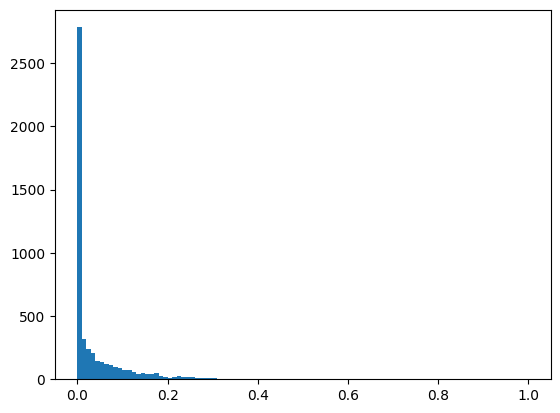

In [52]:
plt.hist(w_prod_norm,bins = 100)

# fit the model !

In [4]:

#create arrays to store variables
#r^2 - coefficient of determination
r2 = np.zeros([perm,n_cog])
#explained variance
var = np.zeros([perm,n_cog])
#correlation between true and predicted (aka prediction accuracy)
corr = np.zeros([perm,n_cog])
#optimised alpha (hyperparameter)
opt_alpha = np.zeros([perm,n_cog])
#predictions made by the model
preds = np.zeros([perm,n_cog,int(np.ceil(X.shape[0]*(1-train_size)))])
#true test values for cognition
cogtest = np.zeros([perm,n_cog,int(np.ceil(X.shape[0]*(1-train_size)))])
#feature importance extracted from the model
featimp = np.zeros([perm,n_feat,n_cog])

NameError: name 'perm' is not defined

In [108]:
#iterate through permutations
for p in range(perm):
    #print permutation # you're on
    print('Permutation %d' %(p+1))
    #split data into train and test sets
    x_train, x_test, cog_train, cog_test = train_test_split(X, Y, test_size=1-train_size, 
                                                            shuffle=True, random_state=p)

    #print(cog_train[:,2])
    w_edu = r_regression(x_test,cog_test[:,2])

    w_cog = r_regression(x_train,cog_train[:,0])
    w_prod = w_cog * w_edu
    w_prod[w_prod < 0] = 0
    w_prod_norm = (w_prod - np.min(w_prod))/(np.max(w_prod)-np.min(w_prod))
    #w_prod_norm[w_prod_norm > 0].shape
    h_idx = np.argpartition(w_prod_norm,-1000)[-1000:]


    x_train = x_train[:,h_idx]
    x_test = x_test[:,h_idx]
    
    #iterate through the cognitive metrics you want to predict
    for cog in range (n_cog):

        #print cognitive metrics being predicted 
        print ("Cognition: %s" % cognition[cog])
        
        #set y values for train and test based on     
        y_train = cog_train[:,cog]
        y_test = cog_test[:,cog]
        
        #store all the y_test values in a separate variable that can be accessed later if needed
        cogtest[p,cog,:] = y_test


        #create variables to store nested CV scores, and best parameters from hyperparameter optimisation
        nested_scores = []
        best_params = []
        

        #optimise regression model using nested CV
        print('Training Models')
        
        #go through the loops of the cross validation
        for i in range(cv_loops):


            #set parameters for inner and outer loops for CV
            inner_cv = KFold(n_splits=k, shuffle=True, random_state=i)
            outer_cv = KFold(n_splits=k, shuffle=True, random_state=i)
            
            #define regressor with grid-search CV for inner loop
            gridSearch = GridSearchCV(estimator=regr, param_grid=paramGrid, n_jobs=-1, 
                                      verbose=0, cv=inner_cv, scoring='r2')

            #fit regressor
            gridSearch.fit(x_train, y_train)

            #save parameters corresponding to the best score
            best_params.append(list(gridSearch.best_params_.values()))

            #call cross_val_score for outer loop
            nested_score = cross_val_score(gridSearch, X=x_train, y=y_train, cv=outer_cv, 
                                           scoring='r2', verbose=1)

            #record nested CV scores
            nested_scores.append(np.median(nested_score))

            #print how many cv loops are complete
            print("%d/%d Complete" % (i+1,cv_loops))
            
        #once all CV loops are complete, fit models based on optimised hyperparameters    
        print('Testing Models')


        #save optimised alpha values
        opt_alpha[p,cog] = np.median(best_params)


        #fit model using optimised hyperparameter
        model = Ridge(fit_intercept = True, alpha = opt_alpha[p,cog], max_iter=1000000)
        model.fit(x_train, y_train);
        
        #compute r^2 (coefficient of determination) 
        r2[p,cog]=model.score(x_test,y_test)

        #generate predictions from model
        preds[p,cog,:] = model.predict(x_test).ravel()
        
        #compute explained variance 
        var[p,cog] = explained_variance_score(y_test, preds[p,cog,:])

        #compute correlation between true and predicted
        corr[p,cog] = np.corrcoef(y_test, preds[p,cog,:])[1,0]

        print(var)

        #extract feature importance
        featimp[p,:,cog] = model.coef_

Permutation 1
Cognition: GCA
Training Models


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.4s finished


1/5 Complete


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.6s finished


2/5 Complete


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.3s finished


3/5 Complete


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.6s finished


4/5 Complete


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.7s finished


5/5 Complete
Testing Models
[[0.29571532 0.        ]
 [0.         0.        ]
 [0.         0.        ]]


ValueError: could not broadcast input array from shape (1000,) into shape (4950,)

array([[5., 0.],
       [0., 0.],
       [0., 0.]])

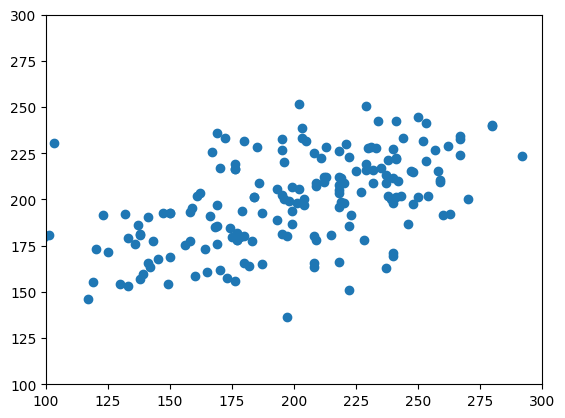

In [111]:
plt.scatter(y_test,preds[0,0,:])
plt.xlim([100,300])
plt.ylim([100,300])
opt_alpha

In [75]:
result_df  = pd.DataFrame()
preds_df  = pd.DataFrame()

for cog_i, cog_names in enumerate(cognition):

        result_df[f'{cog_names}' + '_r2'] = r2[:,cog_i] #fill in the r2 values
        result_df[f'{cog_names}' + '_var'] = var[:,cog_i] #fill in explained variation values
        #result_df[f'{cog_names}' + '_opt_alphas'] = opt_alphas[:,cog_i] #fill in optimal alpha values
        for perm_n in range(preds.shape[0]): 
            preds_df[f'{cog_names}_perm_{perm_n + 1}_preds'] = preds[perm_n,cog_i,:] #fill in preditions
            preds_df[f'{cog_names}_perm_{perm_n + 1}_real'] = cogtest[perm_n,cog_i,:] #fill in real_values
#result_df.to_csv(path + f'results/ridge_regression/ridge_results_atlas-{current_atlas}.csv')
#preds_df.to_csv(path + f'results/ridge_regression/ridge_preds_atlas-{current_atlas}.csv')


In [173]:
y_test.shape[0]

177

In [107]:
result_r2 = pd.DataFrame(columns = [ cog + '_r2' for cog in cognition], data = r2)
result_var = pd.DataFrame(columns = [cog + '_var' for cog in cognition], data = var)

preds_df = pd.DataFrame(columns =[f'{cog + '_var' for cog in cognition}_perm_{perm_n + 1}_preds'] = preds[perm_n,cog_i,:] #fill in preditions
)

SyntaxError: invalid syntax (3831921732.py, line 4)

In [156]:
results_df_2 = pd.concat([result_r2,result_var],axis = 1,sort = False)
results_df_2


,GCA_r2,bmi_r2,GCA_var,bmi_var
0,0.101403,0.066372,0.101457,0.067739
1,0.100034,0.221591,0.105507,0.224079
2,0.100830,0.357360,0.104148,0.357361


In [120]:
preds[:,:,:3]


array([[[197.17868791, 189.99511613, 194.80047304],
        [ 24.47143174,  24.07443411,  21.72111884]],

       [[201.11966116, 191.58085013, 205.40709646],
        [ 27.25616767,  22.29009768,  19.78464665]],

       [[200.72154817, 173.76355981, 195.90744901],
        [ 24.51432071,  24.12014067,  26.78826809]]])

In [147]:
test_df = pd.DataFrame(preds.reshape(6,177).T,columns = column_names)

cogtest.shape

In [157]:
cogtest.shape

(3, 2, 177)

In [148]:


test_df.head()

,GCA_perm_0,bmi_perm_0,GCA_perm_1,bmi_perm_1,GCA_perm_2,bmi_perm_2
0,197.178688,24.471432,201.119661,27.256168,200.721548,24.514321
1,189.995116,24.074434,191.580850,22.290098,173.763560,24.120141
2,194.800473,21.721119,205.407096,19.784647,195.907449,26.788268
3,215.418901,25.249373,203.696077,22.882973,210.460843,22.795650
4,190.836253,22.716668,222.406963,21.961906,188.637082,36.696729


In [170]:
column_names_prep = []
column_names_real = []


for perm_name in range(preds.shape[0]):
    for cog in cognition:
        column_names_prep.append(f'{cog}_perm_{perm_name + 1}_pred')
        column_names_real.append(f'{cog}_perm_{perm_name + 1}_real')

test_df_preds = pd.DataFrame(preds.reshape(6,177).T,columns = column_names_prep)
test_df_real = pd.DataFrame(cogtest.reshape(6,177).T,columns = column_names_real)
test_df = pd.concat([test_df_preds,test_df_real],axis = 1, sort = True)
test_df.head()



,GCA_perm_1_pred,bmi_perm_1_pred,GCA_perm_2_pred,bmi_perm_2_pred,GCA_perm_3_pred,bmi_perm_3_pred,GCA_perm_1_real,bmi_perm_1_real,GCA_perm_2_real,bmi_perm_2_real,GCA_perm_3_real,bmi_perm_3_real
0,197.178688,24.471432,201.119661,27.256168,200.721548,24.514321,130.0,27.0,270.0,20.0,256.0,22.0
1,189.995116,24.074434,191.580850,22.290098,173.763560,24.120141,201.0,22.0,180.0,23.0,197.0,23.0
2,194.800473,21.721119,205.407096,19.784647,195.907449,26.788268,176.0,21.0,128.0,20.0,233.0,24.0
3,215.418901,25.249373,203.696077,22.882973,210.460843,22.795650,241.0,28.0,203.0,25.0,198.0,24.0
4,190.836253,22.716668,222.406963,21.961906,188.637082,36.696729,270.0,22.0,236.0,26.0,105.0,47.0


In [167]:
test_df_preds = pd.DataFrame(preds.reshape(6,177).T,columns = column_names_prep)
test_df_real = pd.DataFrame(cogtest.reshape(6,177).T,columns = column_names_real)
test_df = pd.concat([test_df_preds,test_df_real],axis = 1, sort= True)
test_df.head()

,GCA_perm_1_pred,bmi_perm_1_pred,GCA_perm_2_pred,bmi_perm_2_pred,GCA_perm_3_pred,bmi_perm_3_pred,GCA_perm_1_real,bmi_perm_1_real,GCA_perm_2_real,bmi_perm_2_real,GCA_perm_3_real,bmi_perm_3_real
0,197.178688,24.471432,201.119661,27.256168,200.721548,24.514321,130.0,27.0,270.0,20.0,256.0,22.0
1,189.995116,24.074434,191.580850,22.290098,173.763560,24.120141,201.0,22.0,180.0,23.0,197.0,23.0
2,194.800473,21.721119,205.407096,19.784647,195.907449,26.788268,176.0,21.0,128.0,20.0,233.0,24.0
3,215.418901,25.249373,203.696077,22.882973,210.460843,22.795650,241.0,28.0,203.0,25.0,198.0,24.0
4,190.836253,22.716668,222.406963,21.961906,188.637082,36.696729,270.0,22.0,236.0,26.0,105.0,47.0


(75.0, 300.0)

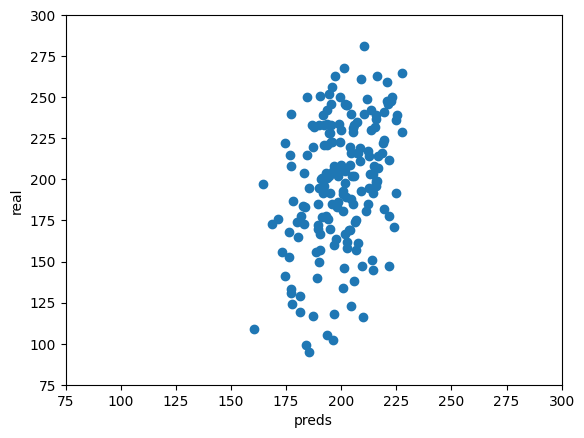

In [60]:
behavior_var = 0
perm = 2
state = perm

x_train, x_test, cog_train, cog_test = train_test_split(X, Y, test_size=1-train_size, 
                                                            shuffle=True, random_state=state)
limits = (75,300)

plt.scatter(preds[perm,behavior_var,:],cogtest[perm,behavior_var,:])
plt.xlabel('preds')
plt.ylabel('real')


plt.xlim(limits)
plt.ylim(limits)


In [346]:
Y.mean(axis = 0)
preds[0,0,:].mean()

200.38126702143467

In [5]:
from nilearn import plotting
from nilearn import datasets
atlas = datasets.fetch_atlas_msdl()
atlas_filemname = atlas['maps']
labels = atlas['labels']


Dataset created in /kyb/agks/sheczko/nilearn_data/msdl_atlas



 ...done. (0 seconds, 0 min)
Extracting data from /kyb/agks/sheczko/nilearn_data/msdl_atlas/8eaecb9e05c478f565847000d9902a25/MSDL_rois.zip..... done.


/kyb/agks/sheczko/.local/lib/python3.10/site-packages/nilearn/plotting/displays/_slicers.py:378: UserWarning:

empty mask



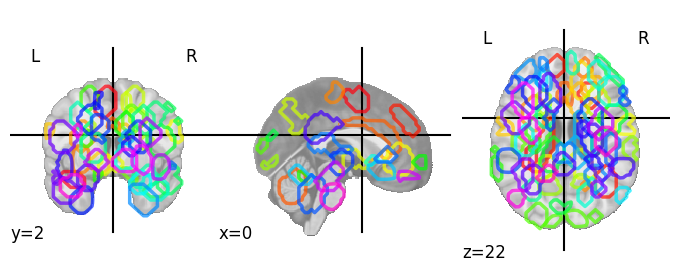

In [11]:
plotting.plot_prob_atlas('/kyb/agks/sheczko/Downloads/MastersThesis/code/data/results/ICA/canICA_space-IBCM_WB_mask_ncomp_200.nii.gz')

In [4]:
from sklearn.utils.fixes import loguniform


In [13]:
loguniform(1e0, 1e3)

In [5]:
CT = 'tangent'

csv_paths  = glob.glob(path + f'/results/connectomes/{CT}_relevant/*.csv')

column_names_importance = []


##load up regresors
regressors_df =  regresson.load_regressors(path + 'func_images/AOMIC/regressors/*.txt')
##choose the target variables, take as np arrays
GCA = regressors_df.regressor_iq.values
bmi = regressors_df.regressor_bmi.values
edu = regressors_df.regressor_edu.values
#print(edu)
 #concatenate cognitive metrics into single variable
cognition = ['GCA'] #nanems o fthe cog metrics used
#cognition = ['PMAT Correct', 'PMAT Response Time']
cog_metric = np.transpose(np.asarray([GCA, edu])) ##the df with the cog ntirics as columns

#set the number of permutations you want to perform
perm = 5
#set the proportion of data you want in your training set
train_size = .8
#set the number of variable you want to predict to be the number of variables stored in the cognition variablse
n_cog = np.size(cognition)
#set regression model type
regr = Ridge(fit_intercept = True, max_iter=1000000)
#regr = LinearRegression(fit_intercept = True, use_gpu=False, max_iter=1000000,dual=True,penalty='l2')
#set y to be the cognitive metrics you want to predict. They are the same for every atlas (each subject has behavioural score regradless of parcellation)
Y = cog_metric




for perm_ixd in range(perm):
    for cog in cognition:
        column_names_importance.append(f'{cog}_perm_{perm_ixd + 1}_importance')
        #column_names_real.append(f'{cog}_perm_{perm_ixd + 1}_real')

#print(data_paths[:4])        

for data_path_i, data_path in enumerate(csv_paths): ##loop over atlases
        
    current_path = csv_paths[data_path_i + 2]
    #current_path = csv_paths[4]
    current_atlas = current_path.split('/')[-1].split('_')[-1].split('.')[0] #change this gives v short names for some of the altases
    print(f'current ' + current_atlas)

    if current_atlas in ('atlas-Schaefer1000','atlas-Slab1068'):

        print('skipping this atlas too many features:(')
        continue

    fc = regresson.load_data(current_path) ##set the imput variable to the current atlas connectome, gives subjects x features matrix

    #set x data to be the input variable you want to use (we use always fc)
    
    X = fc
    X[X<0] = 0 #filter the negative values from the correlations
    #set the number of features 
    
    n_feat = X.shape[1]


    feat_imp = regresson.importance_extractor(X, Y, perm, train_size, n_cog,n_feat,cognition) #gives a matrix (n_perm,n_all_features, n_cog)

    ##save data:

    df_feat = pd.DataFrame(feat_imp.reshape(perm * n_cog,n_feat).T,columns = column_names_importance) ## we flatten the permutation axis 
    #df_real = pd.DataFrame(cogtest.reshape(perm * n_cog,n_pred).T,columns = column_names_real)
    #preds_real_df = pd.concat([df_preds,df_real],axis = 1, sort = True)


    df_feat.to_csv(path + f'results/feature_importance/{CT}/feature_importanace_edu_iq_atlas_{current_atlas}.csv')

NameError: name 'Ridge' is not defined

In [83]:
feat_imp_paths[7]

'data/results/feature_importance/tangent/feature_importanace_edu_iq_atlas-AICHAJoliot2015.csv'

In [82]:
feat_imp_paths = glob.glob(path + 'results/feature_importance/tangent/*.csv')
feat_df_Schaefer = pd.read_csv(feat_imp_paths[7],index_col = 0)

<Axes: >

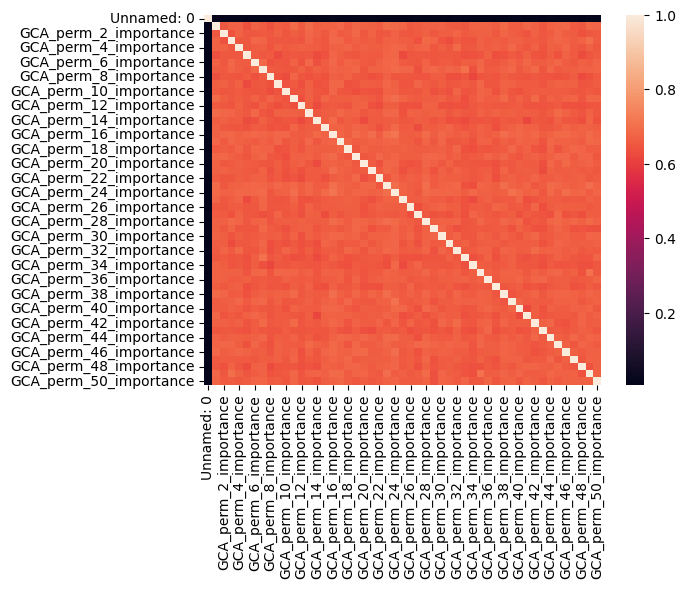

In [25]:
sns.heatmap(feat_df_Schaefer.corr(method = 'pearson'))

In [56]:
feat_df_Schaefer_clean = feat_df_Schaefer
feat_df_Schaefer_clean[feat_df_Schaefer >= 0.5] = 0

<Axes: >

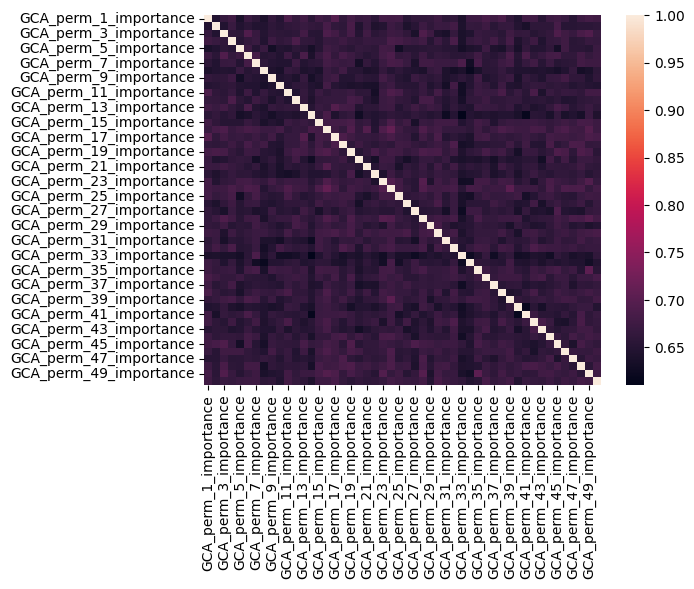

In [84]:
sns.heatmap(feat_df_Schaefer.corr())

In [94]:
feat_df_Schaefer

,GCA_perm_1_importance,GCA_perm_2_importance,GCA_perm_3_importance,GCA_perm_4_importance,GCA_perm_5_importance,GCA_perm_6_importance,GCA_perm_7_importance,GCA_perm_8_importance,GCA_perm_9_importance,GCA_perm_10_importance,...,GCA_perm_41_importance,GCA_perm_42_importance,GCA_perm_43_importance,GCA_perm_44_importance,GCA_perm_45_importance,GCA_perm_46_importance,GCA_perm_47_importance,GCA_perm_48_importance,GCA_perm_49_importance,GCA_perm_50_importance
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.010092,0.000000,0.000000,0.000000,0.000000,0.008777,0.006447,0.024839,0.000000,0.000000,...,0.000000,0.011274,0.004121,0.009888,0.000000,0.013712,0.017253,0.017892,0.000000,0.000000
2,0.074436,0.070087,0.068266,0.068412,0.000000,0.063532,0.052774,0.000000,0.014673,0.064966,...,0.000000,0.000000,0.000000,0.016844,0.077518,0.013307,0.000000,0.053384,0.027224,0.000000
3,0.000000,0.003291,0.000000,0.004888,0.005620,0.000000,0.000000,0.000000,0.000000,0.004344,...,0.000000,0.001790,0.000000,0.000000,0.000000,0.000000,0.005616,0.003140,0.001433,0.004568
4,0.000251,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000257,0.000046,0.000000,...,0.000000,0.000015,0.000000,0.001600,0.000076,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73531,0.000000,0.000000,0.000000,0.000000,0.000000,0.000452,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000618,0.000000,0.000000,0.002698,0.000000,0.000000,0.000000
73532,0.000000,0.000000,0.079077,0.080257,0.107032,0.092426,0.101571,0.000000,0.010053,0.130972,...,0.000000,0.016182,0.073405,0.064879,0.025218,0.079046,0.101841,0.000000,0.000000,0.089888
73533,0.314345,0.154070,0.282047,0.305797,0.370425,0.307325,0.280079,0.228908,0.246634,0.484613,...,0.265686,0.200574,0.077573,0.408879,0.185502,0.234017,0.264430,0.145535,0.194160,0.324387
73534,0.017846,0.000000,0.000000,0.018982,0.021734,0.000000,0.004832,0.021035,0.000000,0.028415,...,0.000000,0.000000,0.000000,0.000000,0.026625,0.000000,0.017346,0.005603,0.000000,0.017086


<Axes: xlabel='GCA_perm_1_importance', ylabel='GCA_perm_10_importance'>

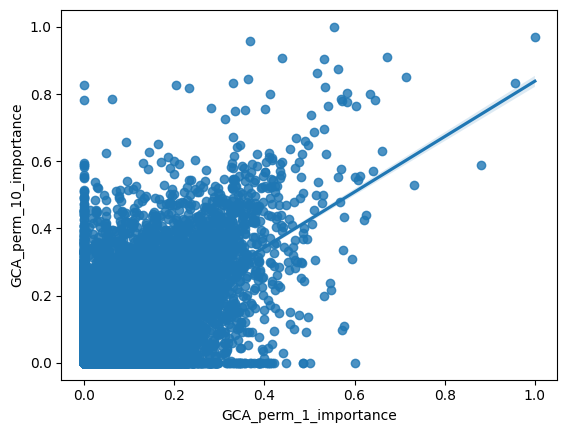

In [87]:
sns.regplot(x = feat_df_Schaefer['GCA_perm_1_importance'],y = feat_df_Schaefer['GCA_perm_10_importance'])


In [88]:
feat_df_Schaefer.mean(axis = 1).nlargest(10)

30968    0.950661
23551    0.668812
61015    0.596685
71842    0.580819
30014    0.575094
34059    0.554538
35375    0.535035
15530    0.531184
24285    0.498431
47941    0.483673
dtype: float64

In [71]:
feat_df_Schaefer.columns

Index(['GCA_perm_1_importance', 'GCA_perm_2_importance',
       'GCA_perm_3_importance', 'GCA_perm_4_importance',
       'GCA_perm_5_importance', 'GCA_perm_6_importance',
       'GCA_perm_7_importance', 'GCA_perm_8_importance',
       'GCA_perm_9_importance', 'GCA_perm_10_importance',
       'GCA_perm_11_importance', 'GCA_perm_12_importance',
       'GCA_perm_13_importance', 'GCA_perm_14_importance',
       'GCA_perm_15_importance', 'GCA_perm_16_importance',
       'GCA_perm_17_importance', 'GCA_perm_18_importance',
       'GCA_perm_19_importance', 'GCA_perm_20_importance',
       'GCA_perm_21_importance', 'GCA_perm_22_importance',
       'GCA_perm_23_importance', 'GCA_perm_24_importance',
       'GCA_perm_25_importance', 'GCA_perm_26_importance',
       'GCA_perm_27_importance', 'GCA_perm_28_importance',
       'GCA_perm_29_importance', 'GCA_perm_30_importance',
       'GCA_perm_31_importance', 'GCA_perm_32_importance',
       'GCA_perm_33_importance', 'GCA_perm_34_importance',
      

In [89]:
df_connetome_schalfer400 = pd.read_csv(path + '/results/connectomes/tangent_relevant/n_sub-881_correlationType-tangent_atlas-AICHAJoliot2015.csv',index_col = 0)

In [93]:
df_connetome_schalfer400.iloc[23551]

subject_0654             -0.001750
subject_0629              0.029132
subject_0506              0.017759
subject_0621              0.041482
subject_0825             -0.010484
                           ...    
subject_0678             -0.072964
subject_0781              0.024091
subject_0872             -0.000153
brain_area_1 (index)     68.000000
brain_area_2 (index)    170.000000
Name: 23551, Length: 883, dtype: float64